In [2]:
import numpy as np                         
import matplotlib                          
import matplotlib.pyplot as plt       
import pykat.optics.maps as pkm
from pykat import finesse                 
from pykat.commands import *               
from pykat.optics.maps import *            
from IPython.display import display, HTML
from matplotlib import animation, rc
import matplotlib.cm as cm
import pandas as pd
import time
from mpl_toolkits.axes_grid1 import make_axes_locatable

%matplotlib inline
pykat.init_pykat_plotting(dpi=90) 

                                              ..-
    PyKat 1.2.1           _                  '(
                          \`.|\.__...-""""-_." )
       ..+-----.._        /  ' `            .-'
   . '            `:      7/* _/._\    \   (
  (        '::;;+;;:      `-"' =" /,`"" `) /
  L.        \`:::a:f            c_/     n_'
  ..`--...___`.  .    ,
   `^-....____:   +.      www.gwoptics.org/pykat



In [3]:
import matplotlib.cm as cm

kat = pykat.finesse.kat()
kat.verbose=False
kat.parse("""
l laser 1 0 0 n0
s s0 1 n0 n1

m1 ITM 0.014 3.75e-05 0 n1 n2
s sCav 3994.4692 n2 n3
m1 ETM 5e-06 3.75e-05 -35 n3 n4

#higher order mode TEM33
tem laser 0 0 0.0 0.0
tem laser 3 3 1.0 0.0

#Gaussian model
cav cavity ITM n2 ETM n3
attr ITM Rc -1934.0
attr ETM Rc 2245.0

maxtem 6

""")

In [4]:
kat1=kat.deepcopy()

kat1.parse("""map ETM Z2-2order100phasemap_finesse.txt
                beam ccd 0 n3
                xaxis ccd x lin -20 20 200
                x2axis ccd y lin -20 20 200
                yaxis abs:deg
        """)

outputNor=pd.DataFrame()
outputUnnor=pd.DataFrame()
for phi in np.arange(101)-100:
    kat1.ETM.phi=phi
    out=kat1.run()
    power1=(np.abs(out["ccd"])/np.max(np.abs(out["ccd"])))**2
    power2=np.abs(out["ccd"])**2
    outputNor['phi'+str(phi)]=power1.reshape(40401)
    outputUnnor['phi'+str(phi)]=power2.reshape(40401)
    
outputNor.to_pickle('pkl/outputNor.pkl')
outputUnnor.to_pickle('pkl/outputUnnor.pkl')    

/opt/anaconda3/lib/python3.7/site-packages/pykat/finesse.py:2114: UserWarning: 'KatRun2D' does not have attribute called 'katPath'
  r.katPath = kat_exec
/opt/anaconda3/lib/python3.7/site-packages/pykat/finesse.py:2345: UserWarning: 'KatRun2D' does not have attribute called 'save_output'
  r.save_output = save_output
/opt/anaconda3/lib/python3.7/site-packages/pykat/finesse.py:2362: UserWarning: 'KatRun2D' does not have attribute called 'save_input'
  r.save_input = save_kat


In [4]:
outputNor_df = pd.read_pickle("pkl/outputNor.pkl")
outputUnnor_df = pd.read_pickle("pkl/outputUnnor.pkl")

In [5]:
matplotlib.rcParams['animation.embed_limit'] = 2**128

start_time = time.time()

fig = plt.figure(figsize=(10,10))
ax0 = fig.add_subplot(221)
ax1 = fig.add_subplot(222)
ax2 = fig.add_subplot(212)
ax0.set_ylim(-20, 20)
ax1.set_ylim(-20, 20)
ax0.set_xlim(-20, 20)
ax1.set_xlim(-20, 20)
ax0.set_title("normalized")
ax1.set_title("unnormalized")



kat2=kat.deepcopy()
kat2.parse("""xaxis ETM phi lin -120 120 200
            yaxis log abs
            map ETM Z2-2order100phasemap_finesse.txt
            ad AD24 2 4 0 n3
            ad AD42 4 2 0 n3
            ad AD15 1 5 0 n3
            ad AD51 5 1 0 n3
            ad AD60 6 0 0 n3
            ad AD06 0 6 0 n3
            ad AD33 3 3 0 n3
            pd Pcirc n3
        """)
out2=kat2.run()

cols = cm.jet(np.linspace(0,1,7))
jj=0
for n in range(7):
    for m in range(7):
        if n+m==6:
            if n>m:
                lineStyle='-.'
            elif n<m:
                lineStyle='-'
            ax2.semilogy(out2.x,abs(out2['AD{}{}'.format(n,m)])**2,lineStyle,color=cols[jj],label='P_{}{}'.format(n,m))
            ax2.set_ylabel('Circulating mode contents [W]')
            ax2.legend(loc=2,bbox_to_anchor=(1,1))
            jj+=1
                
                
ax2.set_ylim(1e-10,1e1)
ax2.set_xlim(-120,50)
im_nor = ax0.imshow([[],[]],extent=[-20, 20, -20, 20])
im_unnor = ax1.imshow([[],[]],extent=[-20, 20, -20, 20])
cbaxes = fig.add_axes([0.035, 0.53, 0.03, 0.35]) 
plt.colorbar(im_nor,cax = cbaxes)
#cbaxes1 = fig.add_axes([0.93, 0.53, 0.03, 0.35]) 
#plt.colorbar(im_un,cax = cbaxes1)


div_unnor = make_axes_locatable(ax1)
cax_unnor = div_unnor.append_axes('right', '10%', '5%')
plt.colorbar(im_unnor,cax = cax_unnor)


turings=np.linspace(-100,0,101,dtype=int)


def animate(turing):
    nor = outputNor_df['phi' + str(turing)].values.reshape(201,201)
    unnor = outputUnnor_df['phi' + str(turing)].values.reshape(201,201)
    im_nor.set_array(nor)
    im_unnor.set_array(unnor)
    vmax_unnor = np.max(unnor)
    vmin_unnor = np.min(unnor)
    im_unnor.set_clim(vmin_unnor, vmax_unnor)
    if turing==-99:
        del ax2.lines[7]
    elif turing==-98:
        del ax2.lines[8]
        del ax2.lines[7]
    elif turing>-98:
        del ax2.lines[7]
    ax2.axvline(x=turing)
    return [im_nor, im_unnor]



anim = animation.FuncAnimation(fig, animate,
                               frames=turings, interval=100, 
                               blit=False)
display(HTML(anim.to_jshtml()))

#Writer = animation.writers['ffmpeg']
#writer = Writer(fps=15, metadata=dict(artist='Me'), bitrate=1800)

#anim.save('anim.mp4', writer=writer)
anim.save('myAnimation.mp4', fps=10)
plt.close(fig)
print("--- %s seconds ---" % (time.time() - start_time))

--- 118.81652402877808 seconds ---


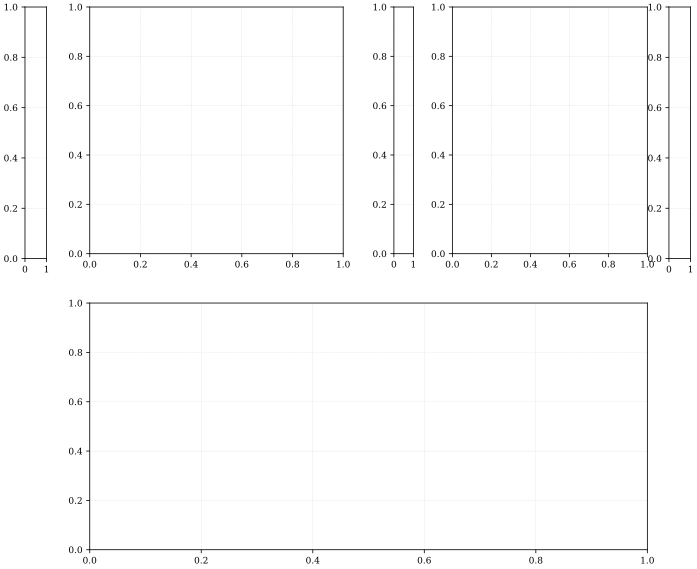

In [67]:
fig = plt.figure(figsize=(10,10))
ax0 = fig.add_subplot(221)
ax1 = fig.add_subplot(222)
ax2 = fig.add_subplot(212)
cbaxes = fig.add_axes([0.035, 0.53, 0.03, 0.35]) 
#plt.colorbar(im_nor,cax = cbaxes)
cbaxes1 = fig.add_axes([0.93, 0.53, 0.03, 0.35]) 
#plt.colorbar(im_un,cax = cbaxes1)

div = make_axes_locatable(ax1)
div.append_axes('left', '10%', '20%')
plt.colorbar(im_nor,cax = cax)

In [43]:
a=[1,2,3,4,5]
del a[1]
a
#a.remove(a.pop(0))

[1, 3, 4, 5]

In [44]:
np.arange(101)-100

array([-100,  -99,  -98,  -97,  -96,  -95,  -94,  -93,  -92,  -91,  -90,
        -89,  -88,  -87,  -86,  -85,  -84,  -83,  -82,  -81,  -80,  -79,
        -78,  -77,  -76,  -75,  -74,  -73,  -72,  -71,  -70,  -69,  -68,
        -67,  -66,  -65,  -64,  -63,  -62,  -61,  -60,  -59,  -58,  -57,
        -56,  -55,  -54,  -53,  -52,  -51,  -50,  -49,  -48,  -47,  -46,
        -45,  -44,  -43,  -42,  -41,  -40,  -39,  -38,  -37,  -36,  -35,
        -34,  -33,  -32,  -31,  -30,  -29,  -28,  -27,  -26,  -25,  -24,
        -23,  -22,  -21,  -20,  -19,  -18,  -17,  -16,  -15,  -14,  -13,
        -12,  -11,  -10,   -9,   -8,   -7,   -6,   -5,   -4,   -3,   -2,
         -1,    0])